In [1]:
!pip install imagecodecs

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 35.3 MB/s eta 0:00:00


In [2]:
!pip show imagecodecs

Name: imagecodecs
Version: 2023.9.18
Summary: Image transformation, compression, and decompression codecs
Home-page: https://www.cgohlke.com
Author: Christoph Gohlke
Author-email: cgohlke@cgohlke.com
License: BSD
Location: /usr/local/lib/python3.10/dist-packages
Requires: numpy
Required-by: 


In [3]:
!pip install --upgrade tifffile

In [15]:
!pip uninstall -y tensorflow
!pip install tensorflow==2.14.0

Found existing installation: tensorflow 2.12.0
Uninstalling tensorflow-2.12.0:
  Successfully uninstalled tensorflow-2.12.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 489.8/489.8 MB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 75.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.7/440.7 kB 33.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 68.4 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.12.0
    Uninstalling tensorflow-estimator-2.12.0:
      Successfully uninstalled tensorflow-estimator-2.12.0
  Attempting uninstall: keras
    Found existing installation: keras 2.12.0
    Uninstalling keras-2.12.0:
      Successfully uninstalled keras-2.12.0
  Attempting uninstall: google-auth-oauthlib
    Found existing installation: google-auth-oauthlib 0.4.6
    Uninstalling google-auth-oauthlib-0.4.6:
      Successfully uninstalled google-aut

In [5]:
!pip install tifffile

In [6]:
!pip install --upgrade Pillow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 14.3 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageio 2.31.6 requires pillow<10.1.0,>=8.3.2, but you have pillow 10.1.0 which is incompatible.


In [7]:
!pip install rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 54.8 MB/s eta 0:00:00


In [12]:
!pip install rioxarray

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.7/53.7 kB 1.0 MB/s eta 0:00:00


In [1]:
## Making essential imports
import os
import numpy as np
import pandas as pd
import re
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
import tifffile
import imagecodecs


## repeated printouts and wide-format text:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [2]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
images_folder = '/content/drive/My Drive/2years_visual_full/'

In [4]:
model_folder = '/content/drive/My Drive/final_models/'

In [5]:
from keras.metrics import MeanIoU
from keras import backend as K

# Define the custom metric function
def mean_iou(y_true, y_pred):
    intersection = K.sum(K.abs(y_true * K.round(y_pred)))
    union = K.sum(K.abs(y_true) + K.abs(K.round(y_pred)) - y_true * K.round(y_pred))
    iou = intersection / (union + K.epsilon())
    return iou

In [6]:
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import numpy as np
import matplotlib.pyplot as plt

# Load the model
model = load_model(os.path.join(model_folder,'model_unet_iou.keras'), custom_objects={'mean_iou': mean_iou})

In [ ]:
print(os.path.join(model_folder,'model_attention_unet.keras'))

/content/drive/My Drive/final_models/model_attention_unet.keras


In [13]:
import rasterio
import matplotlib.pyplot as plt
import numpy as np
from rasterio.plot import show
import rioxarray as rxr

In [14]:
def preprocess_test_images(complete_file_path):
    a = (np.array(rxr.open_rasterio(complete_file_path)))
    a = (a-np.min(a)) / (np.max(a)-np.min(a))

    output_size = (512, 512)

    # Reshape and resize using cv2.resize
    reshaped_image = cv2.resize(a.transpose(1, 2, 0), output_size)

    # Select the first three channels
    reshaped_image = reshaped_image[:, :, :3]

    # Add an additional dimension for batch size
    reshaped_image = reshaped_image[np.newaxis, :, :, :]

    # # Verify the shape of the reshaped image
    # print(reshaped_image.shape)

    return reshaped_image

In [15]:
def LoadData_testing(frameObj=None, original_images_folder_path= None):
    imgNames = [f for f in os.listdir(original_images_folder_path) if f.endswith('.tiff') or f.endswith('.tif')]
    for imgName in imgNames:
        img = preprocess_test_images(os.path.join(original_images_folder_path, imgName))
        frameObj['img'].append(img)
    return frameObj

framObjTest = {'img' : []}

framObjTest = LoadData_testing(framObjTest, original_images_folder_path = images_folder)

In [19]:
def predict16_test(framObj, model):
    print("Getting images")
    imgList = framObj['img']

    print("#############3")
    imgProc = np.array(imgList)
    # Ensure images are correctly resized and stacked for model input
    imgProc = np.squeeze(imgProc, axis=1)

    # for img in imgList:
    #     if img is not None:  # Check for a valid image shape
    #         resized_img = cv2.resize(img, (512, 512))
    #         imgProc.append(resized_img)
    #     else:
    #         print("Invalid image shape or None image, skipping...")
    # imgProc = np.array(imgList)

    # imgProc = np.expand_dims(imgProc, axis=0)

    print("######################## Getting predictions")
    predictions = model.predict(imgProc)

    print("######################## Is this packing?")
    # new_predictions = []
    # for i in range(len(predictions)):
    #     merged_prediction = cv2.merge((predictions[i, :, :, 0],
    #                                    predictions[i, :, :, 1],
    #                                    predictions[i, :, :, 2]))
    #     new_predictions.append(merged_prediction)

    return np.array(predictions), imgProc

In [20]:
sixteenPrediction, actuals = predict16_test(framObjTest, model)

Getting images
#############3
######################## Getting predictions
3/3 [==============================] - 36s 10s/step
######################## Is this packing?


<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

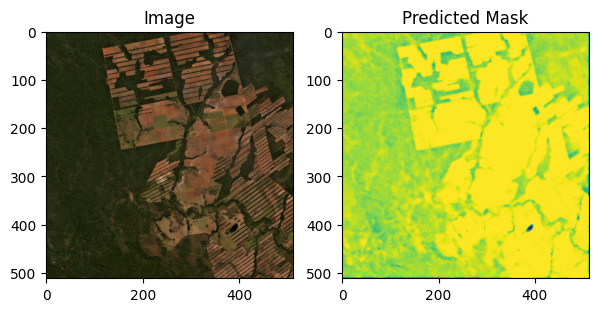

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

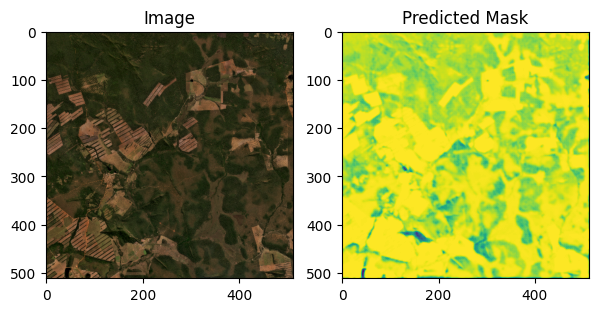

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

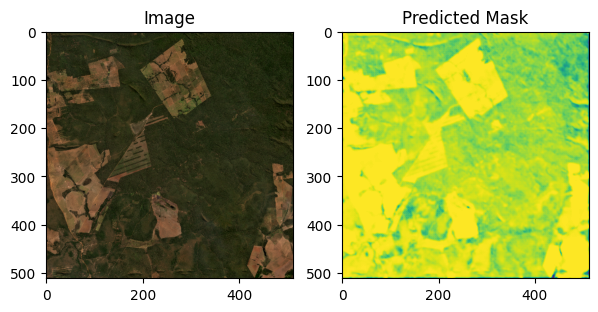

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

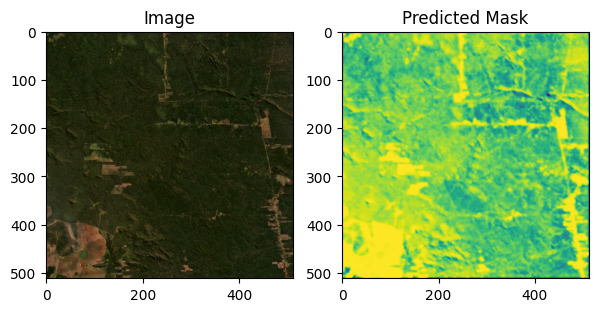

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

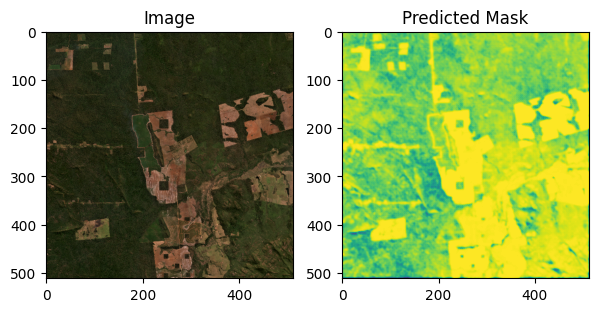

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

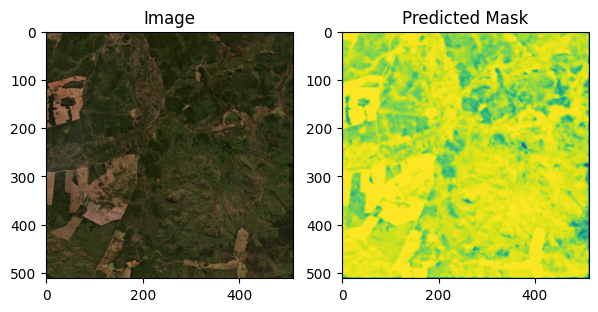

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

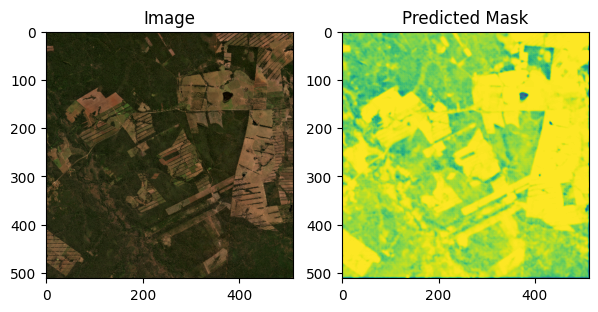

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

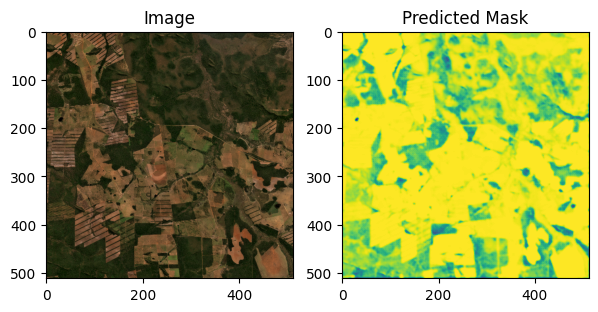

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

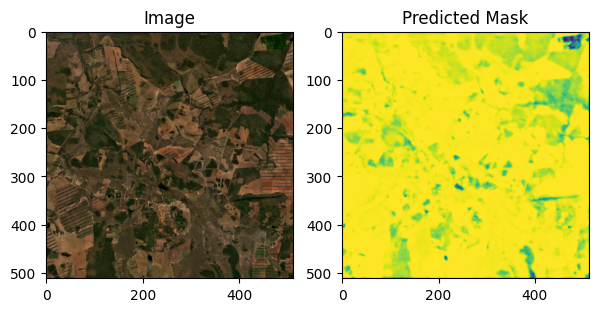

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

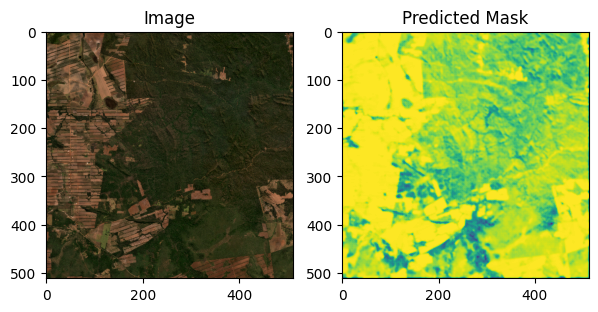

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

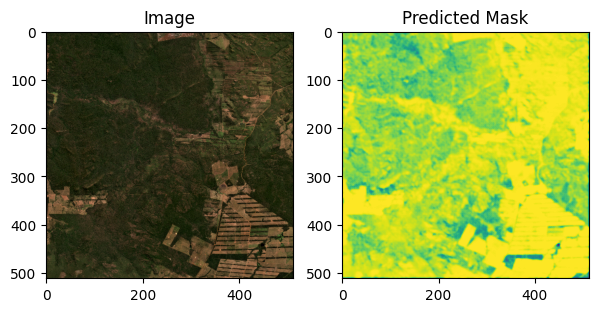

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

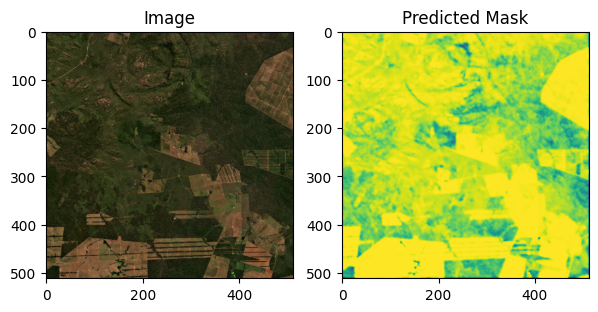

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

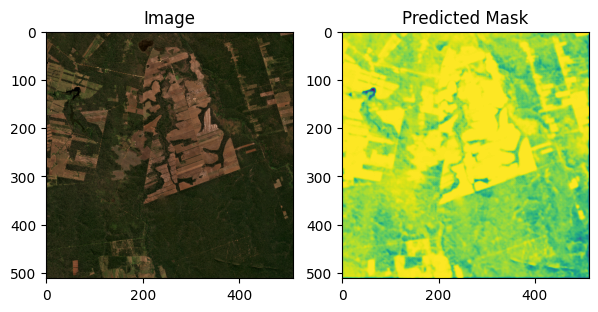

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

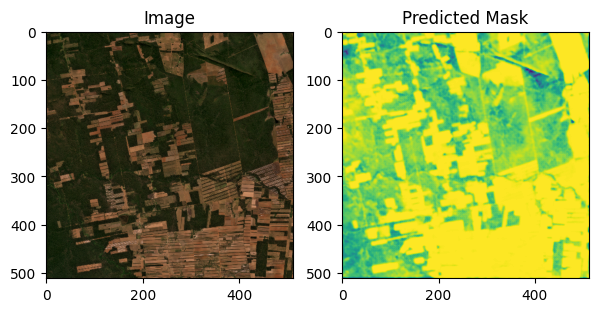

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

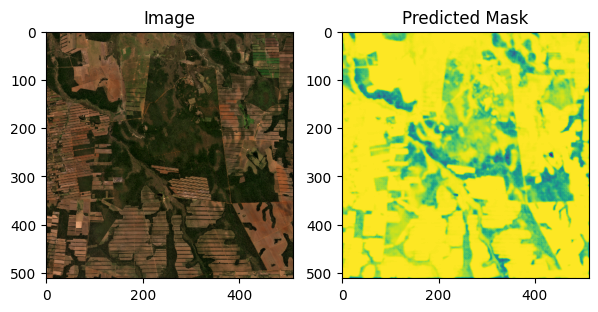

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

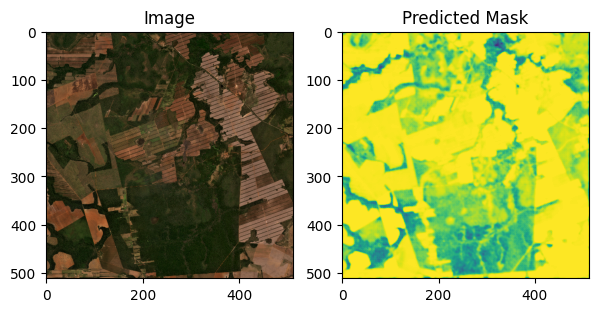

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

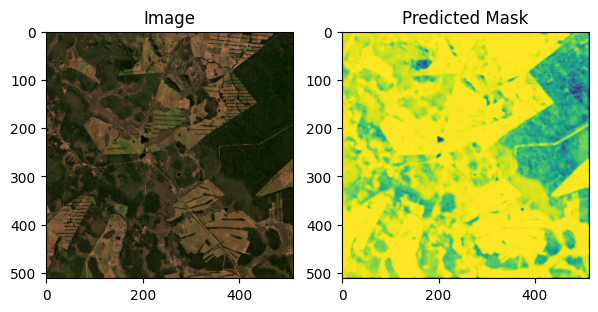

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

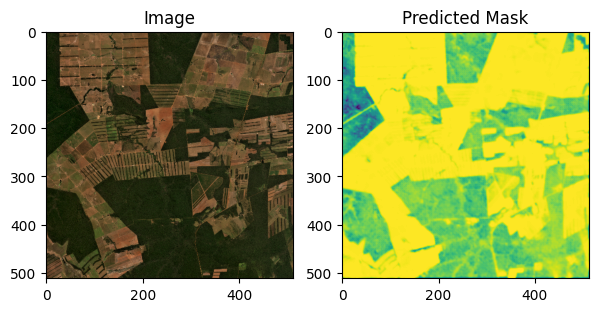

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

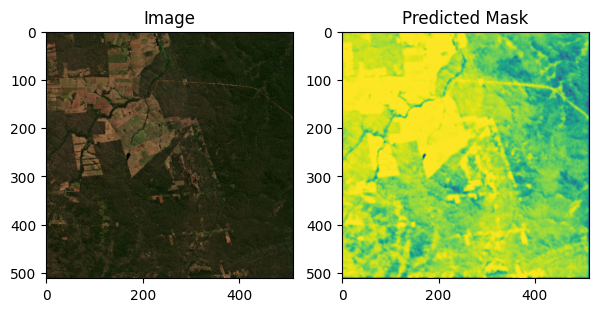

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

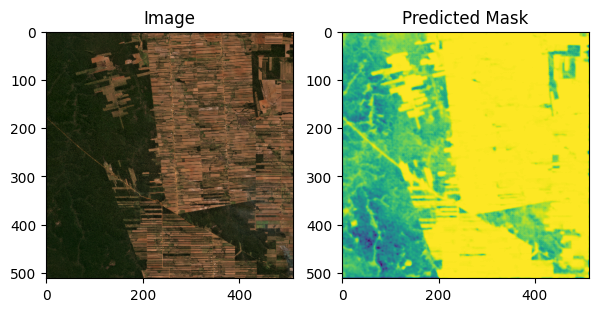

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

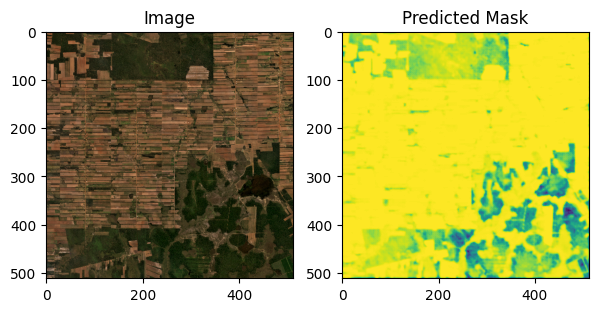

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

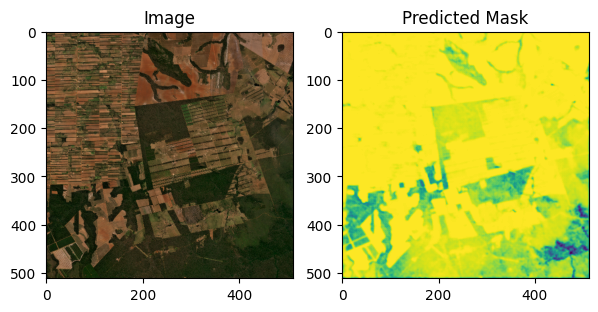

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

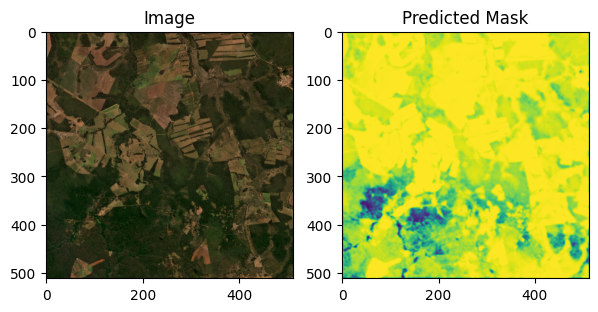

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

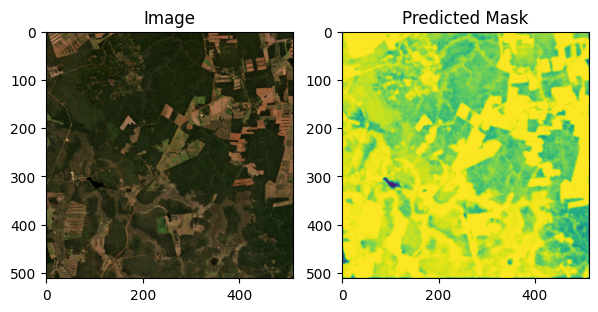

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

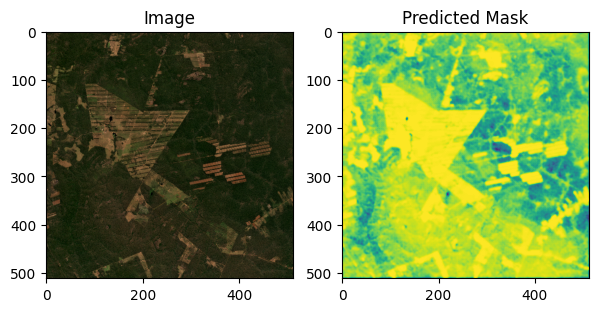

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

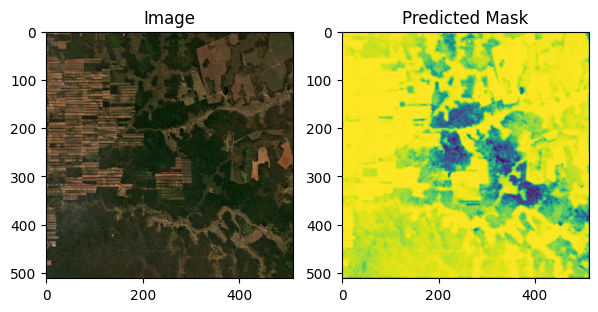

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

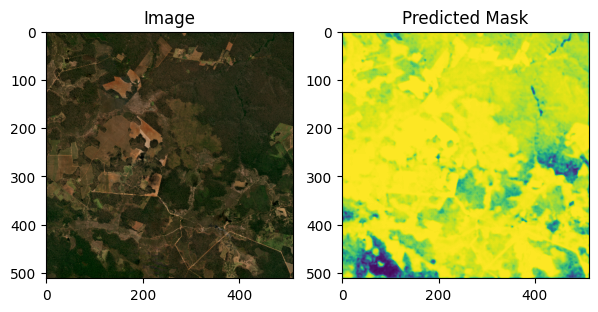

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

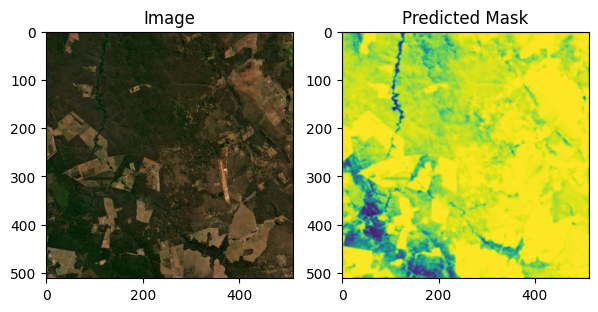

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

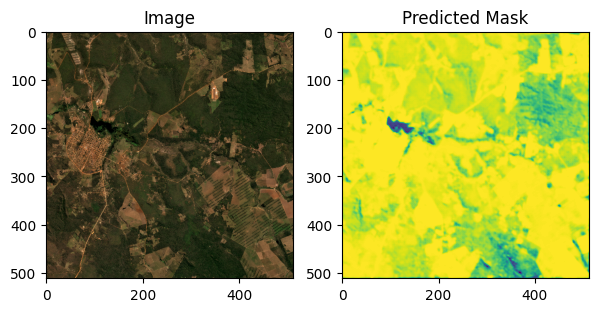

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

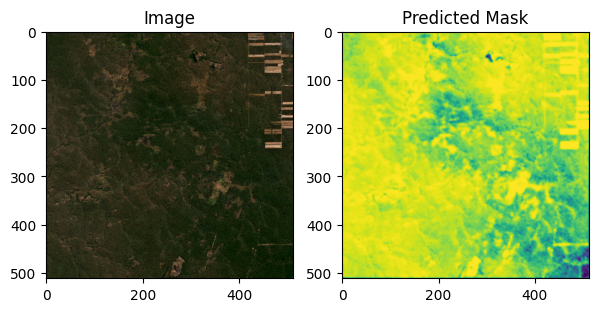

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

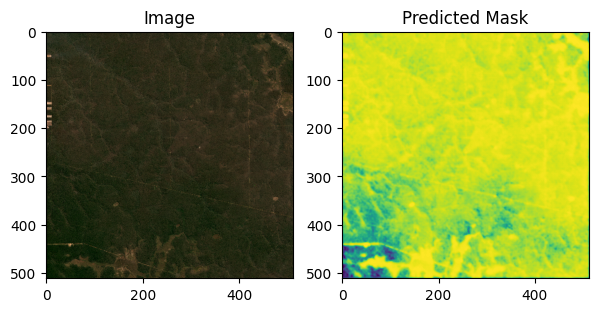

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

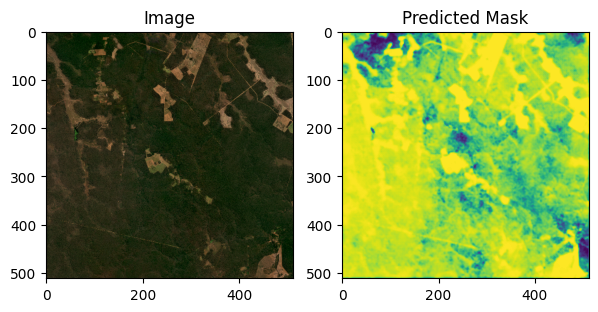

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

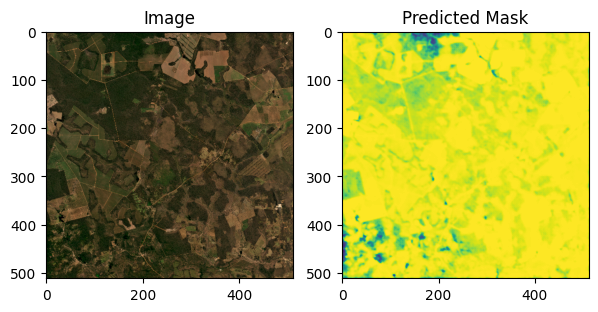

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

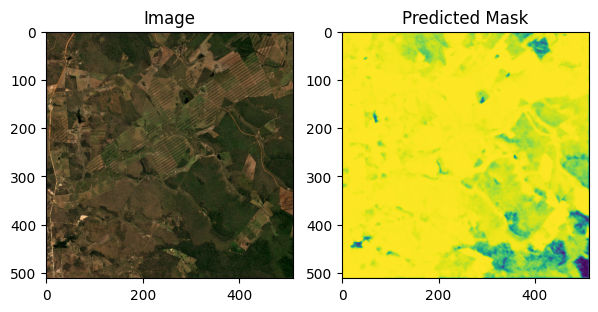

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

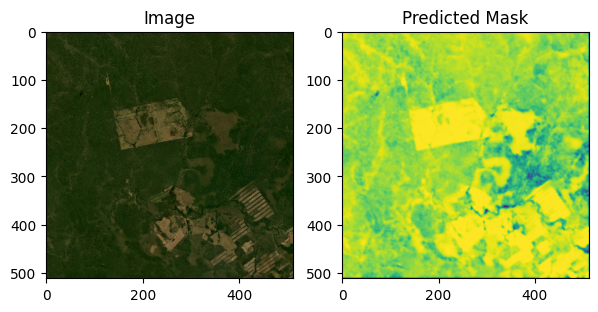

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

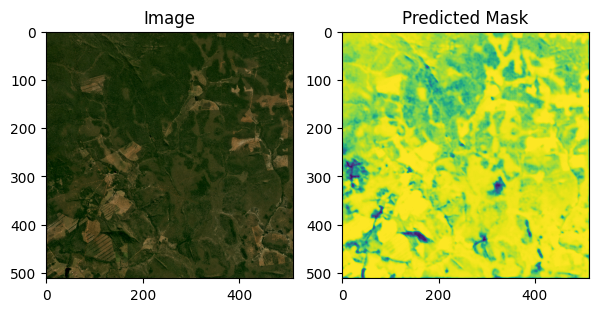

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

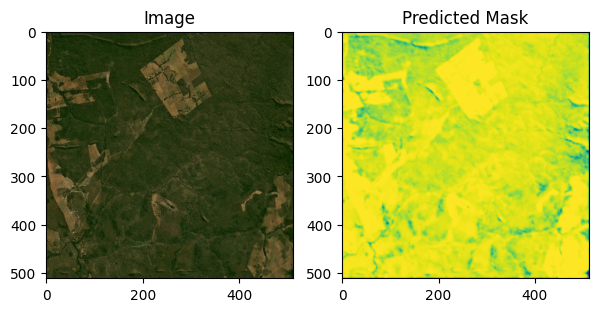

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

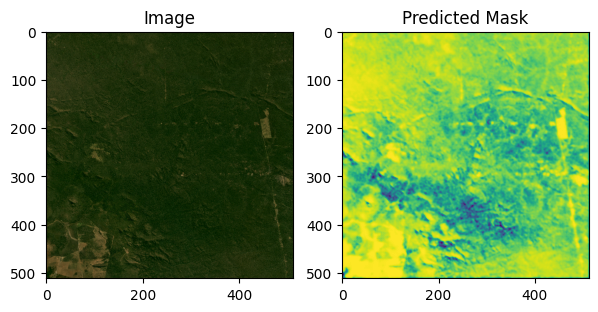

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

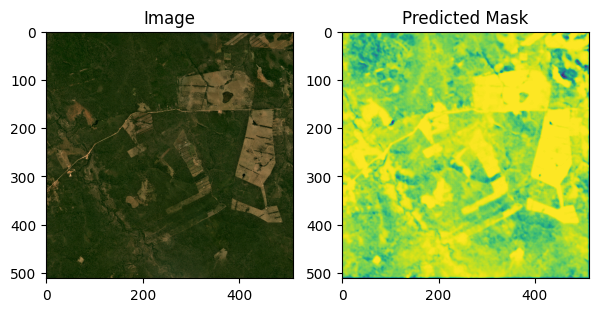

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

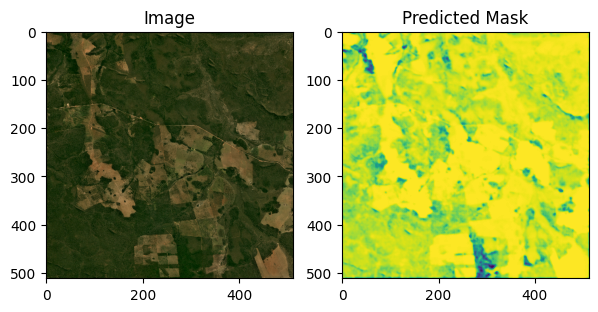

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

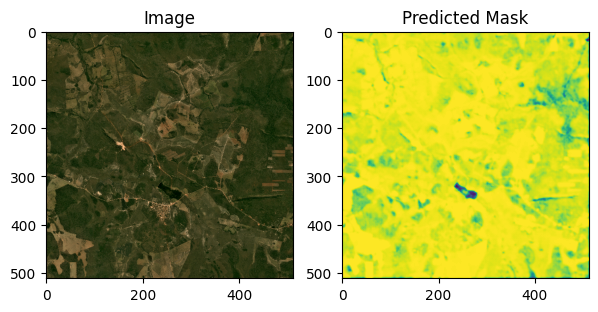

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

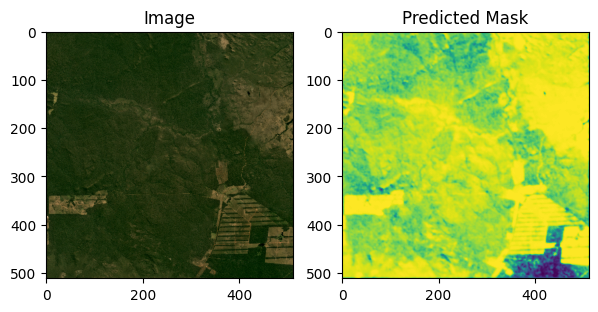

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

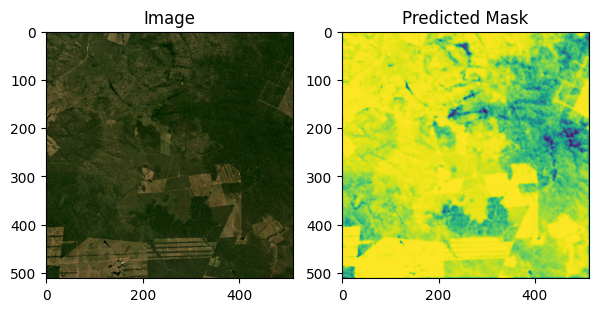

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

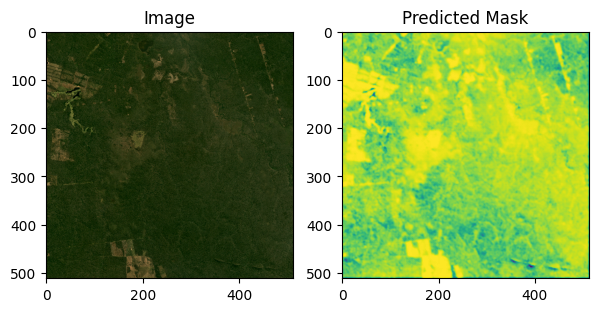

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

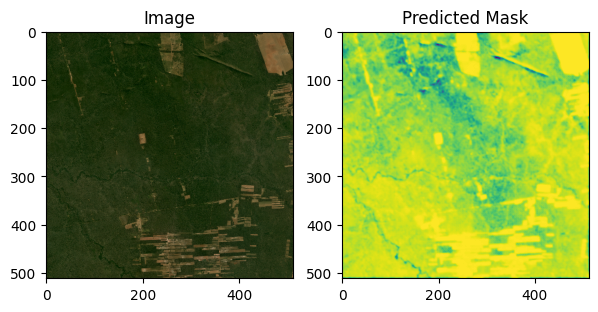

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

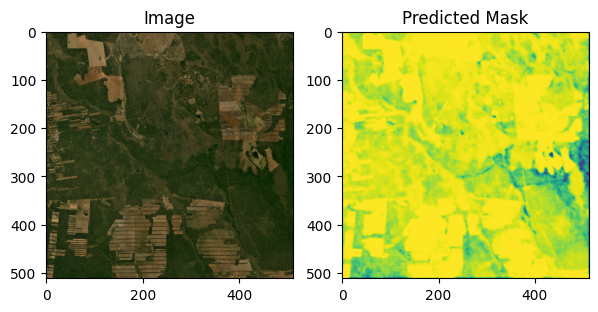

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

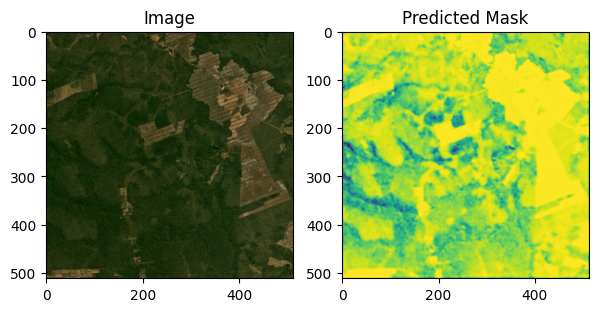

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

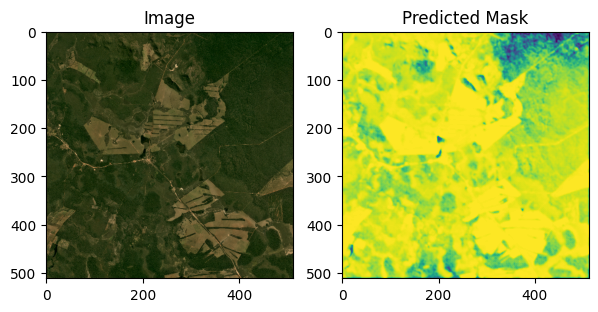

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

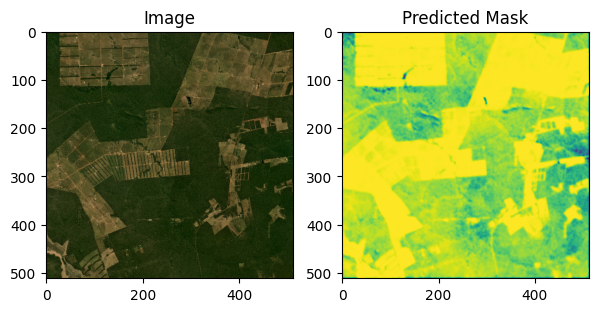

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

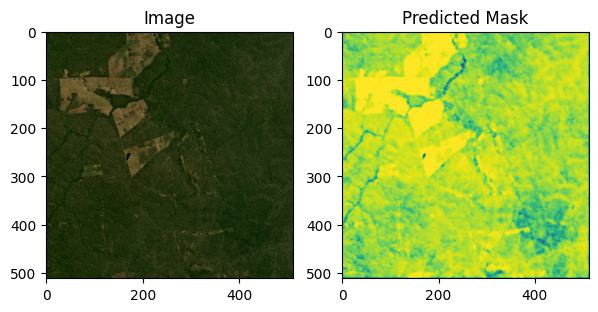

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

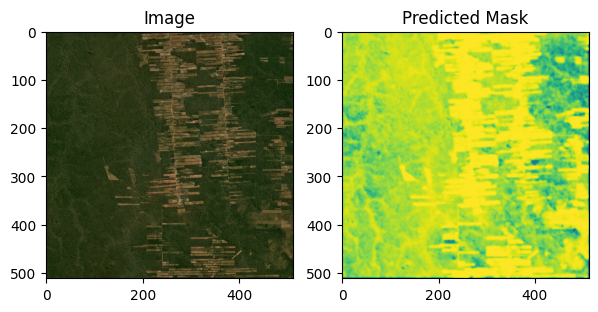

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

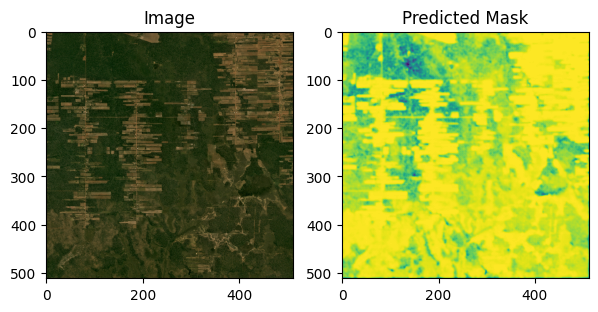

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

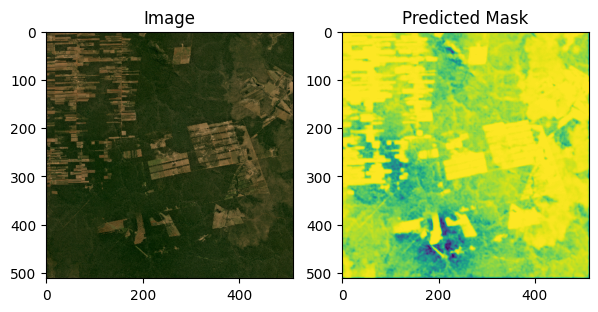

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

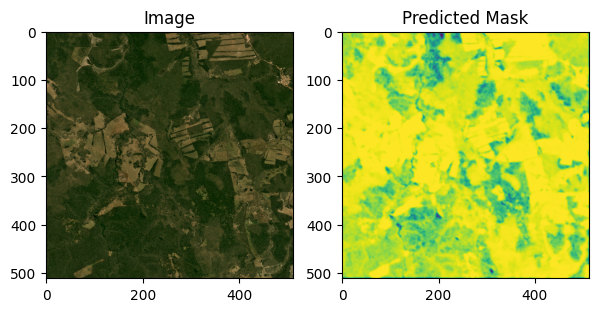

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

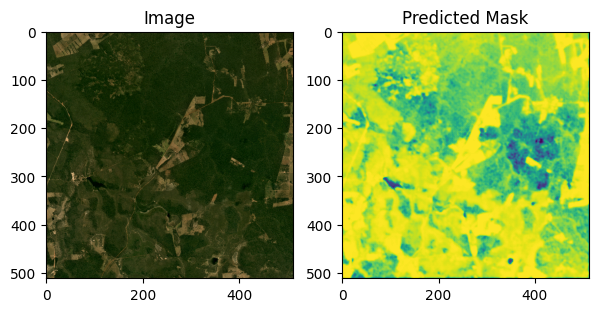

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

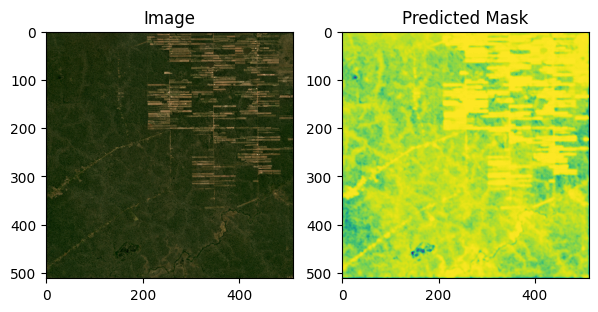

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

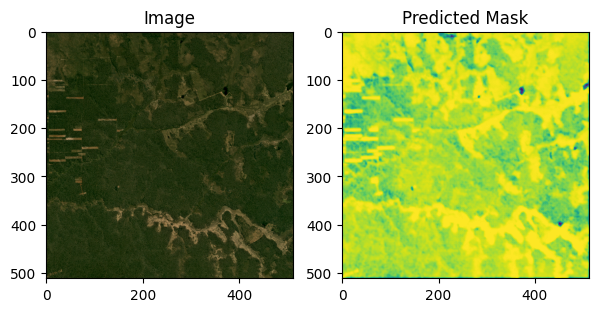

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

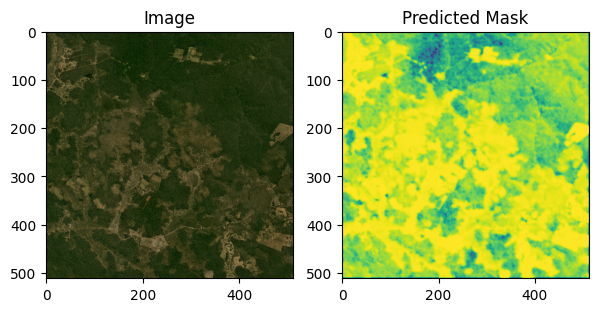

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

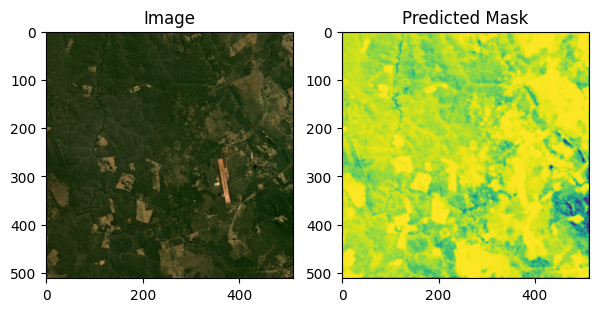

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

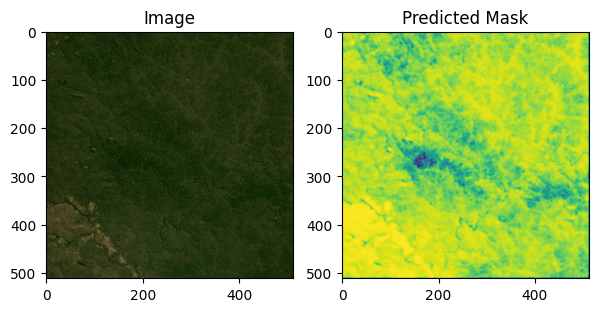

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

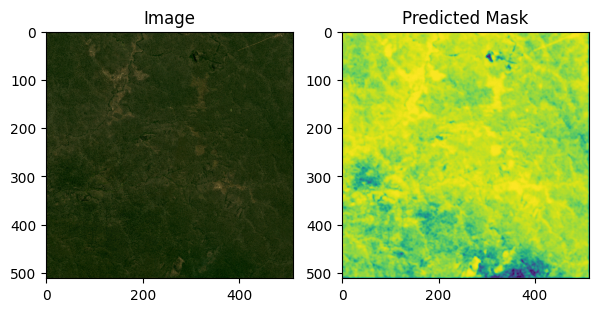

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

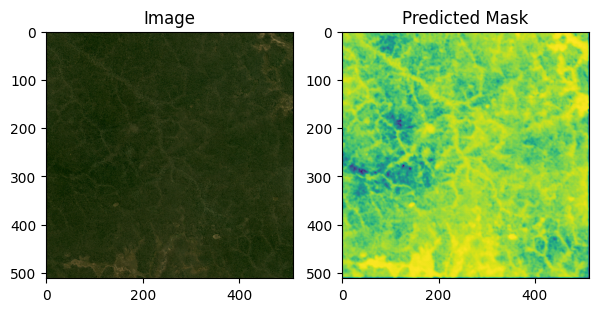

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

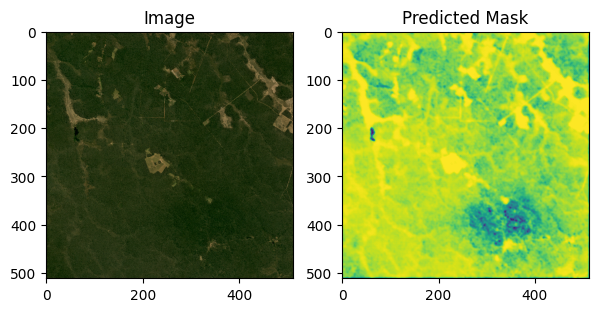

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

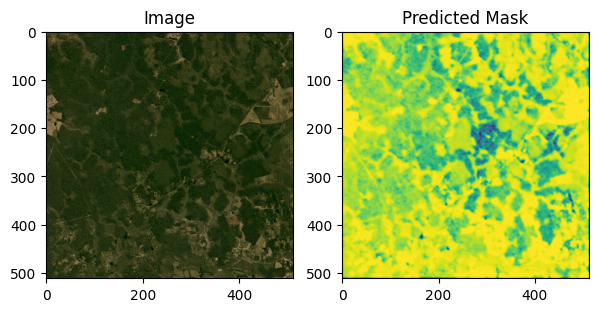

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

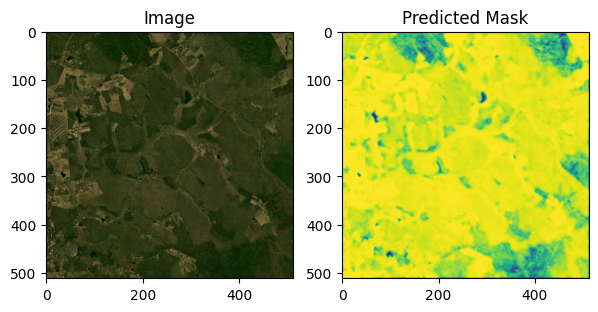

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

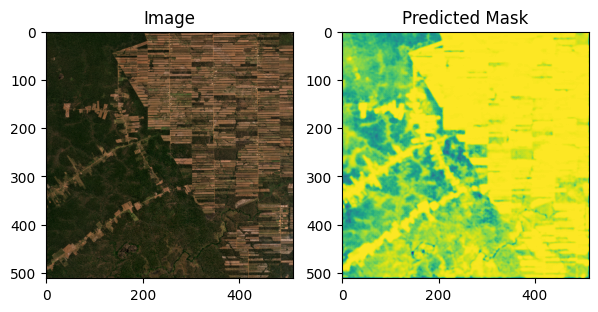

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

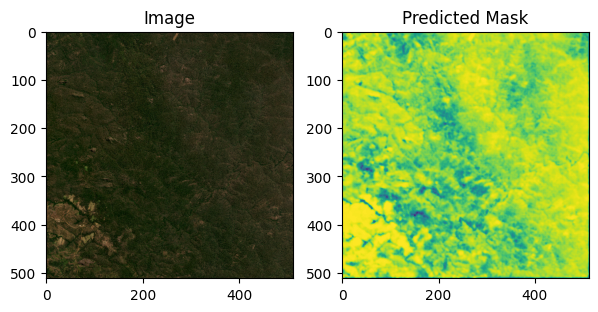

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

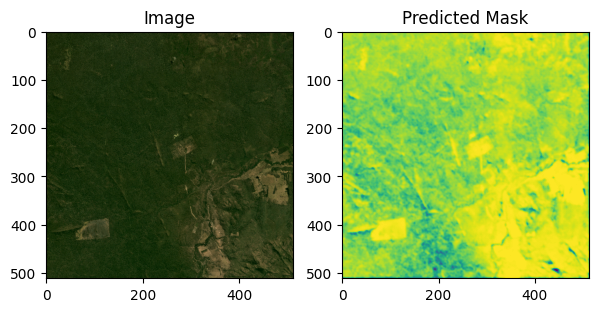

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

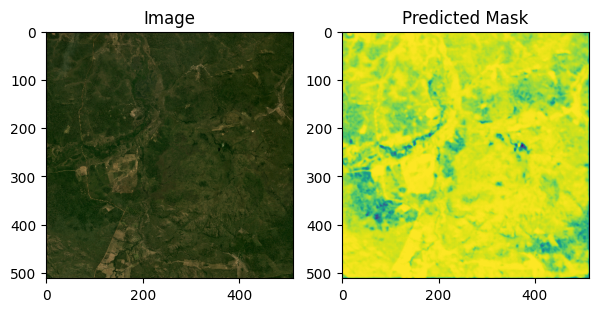

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

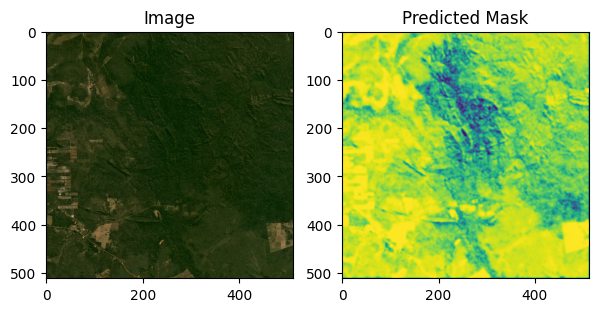

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

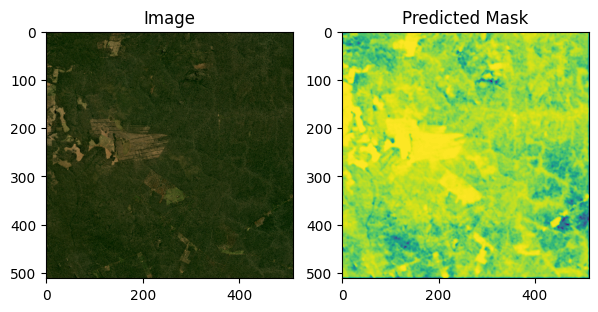

<Figure size 700x700 with 0 Axes>

<Axes: >

Text(0.5, 1.0, 'Image')

<Axes: >

Text(0.5, 1.0, 'Predicted Mask')

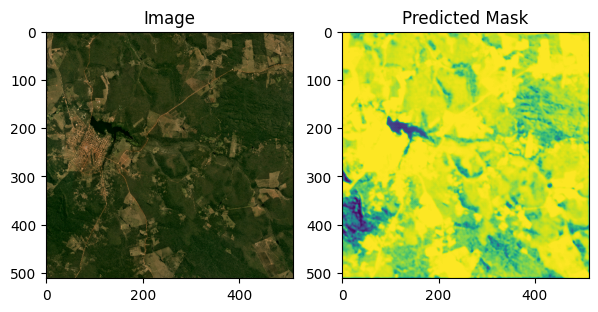

In [21]:
import matplotlib.pyplot as plt
import numpy as np

for i in range(len(sixteenPrediction)):
    plt.figure(figsize=(7,7))

    # Assuming 'framObjTest['img'][i]' has shape (1, 512, 512, 3)
    # Reshape the image to (512, 512, 3) for display
    image = np.squeeze(framObjTest['img'][i])

    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Image')

    plt.subplot(1, 2, 2)
    # Assuming 'sixteenPrediction[i]' has shape (1, 512, 512, 3)
    # Reshape the predicted mask to (512, 512, 3) for display
    predicted_mask = np.squeeze(sixteenPrediction[i])
    plt.imshow(predicted_mask)
    plt.title('Predicted Mask')

    plt.show()